In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import cv2 as cv
from collections import defaultdict

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html = 'jshtml')

In [18]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, title, repeat = False, interval = 40):
    fig = plt.figure()
    patch = plt.imshow(frames[0], cmap = 'gray')
    plt.title(title)
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat = repeat, interval = interval)
    plt.close()
    return anim

In [19]:
img = cv.imread('56.jpg', flags = cv.IMREAD_GRAYSCALE)/255 # Scaling the image
img = np.expand_dims(img, axis = 2)

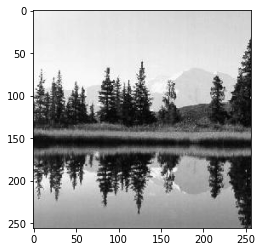

In [20]:
plt.imshow(img, cmap = 'gray')

In [21]:
img.shape

(256, 256, 1)

## Eigen Value Decomposition

In [22]:
def compress_image_evd(M, k = 100):
    w, v = np.linalg.eig(M)
    sort_eig_val = sorted(w, key = lambda x: -abs(x))[:k]
    w_compress = []
    for i in range(w.shape[0]):
        if w[i] in sort_eig_val or np.conj(w[i]) in sort_eig_val:
            w_compress.append(w[i])
        else:
            w_compress.append(0 + 0j)
    a = np.dot(v, np.diag(w_compress))
    a = np.dot(a, np.linalg.inv(v)) 
    return np.real(a)

def norm_vs_k(img, fun, start, end, step = 10):
    n_channels = img.shape[-1]
    norm = defaultdict(list)
    r_imgs = []
    for n in range(start, end + 1, step):
        r_img = []
        for c in range(n_channels):
            M = img[:, :, c]
            r_img_c = fun(M, k = n)
            norm[c].append(np.linalg.norm(M - r_img_c, ord = 'fro'))
            r_img.append(np.expand_dims(r_img_c, axis = 2))
        r_imgs.append(np.concatenate(r_img, axis = 2))
    return norm, r_imgs

In [23]:
START = 1
END = 256
STEP = 2
frobenius_norm, frames = norm_vs_k(img, compress_image_evd, start = START, end = END, step = STEP)

In [24]:
# Evolution of the reconstructed images
anim = plot_animation(frames, 'Evolution of the reconstructed images - EVD')

In [25]:
f = r"EVD.gif" 
writer = animation.PillowWriter(fps = 60) 
anim.save(f, writer = writer)

In [26]:
anim

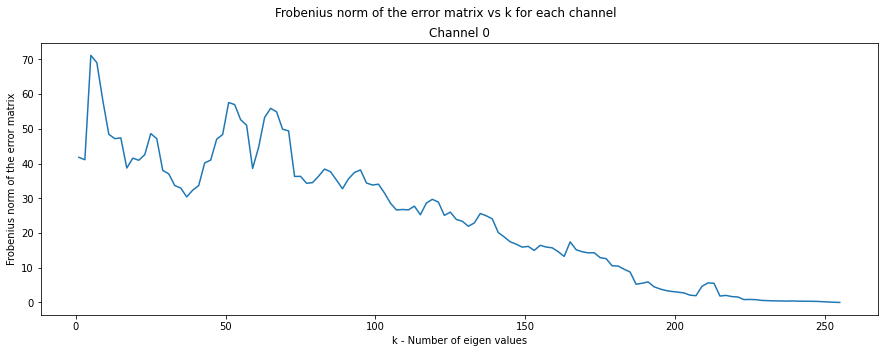

In [27]:
fig = plt.figure(figsize = (15, 5))
plt.suptitle('Frobenius norm of the error matrix vs k for each channel')
for n in range(img.shape[-1]):
    plt.subplot(1, img.shape[-1], n + 1)
    plt.plot(range(START, END, STEP), frobenius_norm[n])
    plt.title('Channel {}'.format(n))
    plt.xlabel('k - Number of eigen values')
    if not n:
        plt.ylabel('Frobenius norm of the error matrix')
plt.savefig('a.png')

In [28]:
K_evd = 180
recons_img = []
for n in range(img.shape[-1]):
    M = img[:, :, n]
    Md = compress_image_evd(M, k = K_evd)
    print('The Frobenius norm of the reconstruction error matrix using EVD (k = {}) - Channel {}: '.format(K_evd, n), np.linalg.norm(M - Md, ord = 'fro'))
    recons_img.append(np.expand_dims(Md, axis = 2))
recons_img_evd = np.concatenate(recons_img, axis = 2)

The Frobenius norm of the reconstruction error matrix using EVD (k = 180) - Channel 0:  10.48985172663697


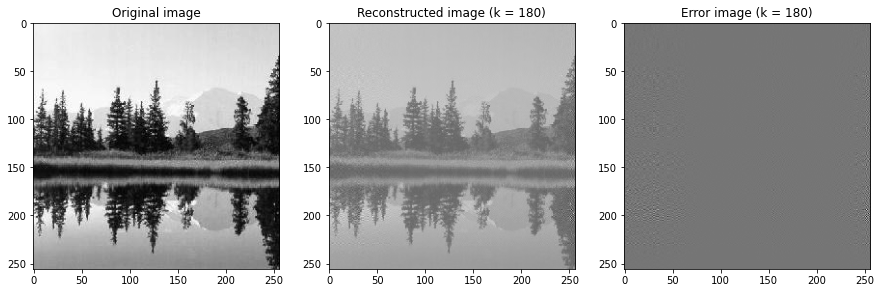

In [29]:
fig = plt.figure(figsize = (15, 15))
plt.subplot(1, 3, 1)
plt.imshow(img, cmap = 'gray')
plt.title('Original image')

plt.subplot(1, 3, 2)
plt.imshow(recons_img_evd, cmap = 'gray')
plt.title('Reconstructed image (k = {})'.format(K_evd))

plt.subplot(1, 3, 3)
plt.imshow(img - recons_img_evd, cmap = 'gray')
plt.title('Error image (k = {})'.format(K_evd))

plt.savefig('a.png')

## Singular Value Decomposition

In [30]:
def svd(M):
    MtM = np.dot(np.matrix.transpose(M), M)
    MMt = np.dot(M, np.matrix.transpose(M))
    S2V, V = np.linalg.eig(MtM)
    S2U, U = np.linalg.eig(MMt)
    m = len(S2U); n = len(S2V)
    sin_U = dict(); sin_V = dict()
    for i in range(max(m, n)):
        if i < m:
            sin_U[S2U[i]] = U[:, i]
        if i < n:
            sin_V[S2V[i]] = V[:, i]
    S2U = sorted(S2U, reverse = True); 
    S2V = sorted(S2V, reverse = True)
    u = np.zeros((m, m)); v = np.zeros((n, n))
    for i in range(max(m, n)):
        if i < m:
            u[:, i] = sin_U[S2U[i]]
        if i < n:
            v[:, i] = sin_V[S2V[i]]
    s = np.dot(np.matrix.transpose(u), M)
    s = np.dot(s, v)
    for i in range(min(m, n)):
        if s[i, i] < 0:
            s[i, i] = -s[i, i]
            v[:, i] = -v[:, i]
    return u, s, v

def compress_image_svd(M, k = 100):
    U, S, V = svd(M)
    Uk = U[:, :k]
    Vk = V[:, :k]
    Sk = S[:k, :k]
    a = np.dot(Uk, Sk)
    return np.dot(a, np.matrix.transpose(Vk))

In [31]:
START = 1
END = 256
STEP = 2
frobenius_norm, frames = norm_vs_k(img, compress_image_svd, start = START, end = END, step = STEP)

In [32]:
# Evolution of the reconstructed images
anim = plot_animation(frames, 'Evolution of the reconstructed images - SVD')

In [33]:
f = r"SVD.gif" 
writer = animation.PillowWriter(fps = 60) 
anim.save(f, writer = writer)

In [34]:
anim

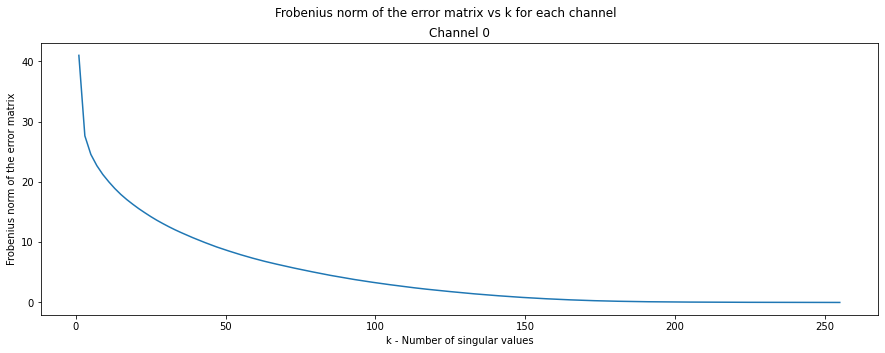

In [35]:
fig = plt.figure(figsize = (15, 5))
plt.suptitle('Frobenius norm of the error matrix vs k for each channel')
for n in range(img.shape[-1]):
    plt.subplot(1, img.shape[-1], n + 1)
    plt.plot(range(START, END, STEP), frobenius_norm[n])
    plt.title('Channel {}'.format(n))
    plt.xlabel('k - Number of singular values')
    if not n:
        plt.ylabel('Frobenius norm of the error matrix')
plt.savefig('a.png')

In [36]:
K_svd = 50
recons_img = []
for n in range(img.shape[-1]):
    M = img[:, :, n]
    Md = compress_image_svd(M, k = K_svd)
    print('The Frobenius norm of the reconstruction error matrix using SVD (k = {}) - Channel {}: '.format(K_svd, n), np.linalg.norm(M - Md, ord = 'fro'))
    recons_img.append(np.expand_dims(Md, axis = 2))
recons_img_svd = np.concatenate(recons_img, axis = 2)

The Frobenius norm of the reconstruction error matrix using SVD (k = 50) - Channel 0:  8.70687173576408


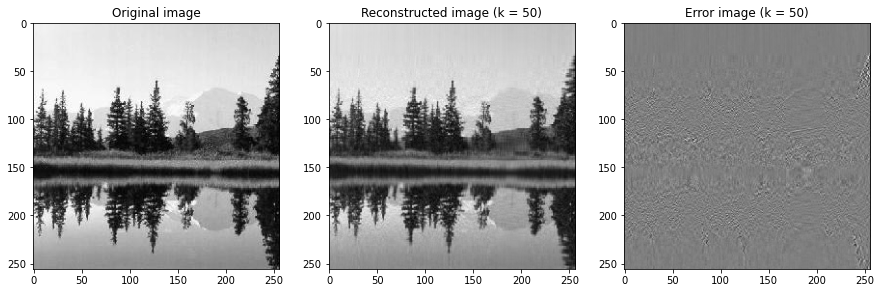

In [37]:
fig = plt.figure(figsize = (15, 15))
plt.subplot(1, 3, 1)
plt.imshow(img, cmap = 'gray')
plt.title('Original image')

plt.subplot(1, 3, 2)
plt.imshow(recons_img_svd, cmap = 'gray')
plt.title('Reconstructed image (k = {})'.format(K_svd))

plt.subplot(1, 3, 3)
plt.imshow(img - recons_img_svd, cmap = 'gray')
plt.title('Error image (k = {})'.format(K_svd))

plt.savefig('a.png')